In [19]:
import numpy as np
import matplotlib.pyplot as plt
import pandas
import pandas as pd

In [2]:
df = pandas.read_pickle("data/gedi/combined_df_preprocessed.pkl")

In [3]:
df.columns


Index(['rh', 'dataset', 'y_normalized', 'rx_sample_start_index',
       'rx_sample_count', 'geolocation/latitude_bin0',
       'geolocation/longitude_bin0', 'geolocation/elevation_bin0',
       'geolocation/elevation_lastbin', 'geolocation/delta_time',
       'shot_number', 'quality_flag', 'sensitivity', 'solar_elevation',
       'degrade_flag', 'elev_lowestmode', 'elev_highestreturn',
       'land_cover_data/landsat_treecover',
       'land_cover_data/modis_nonvegetated', 'land_cover_data/modis_treecover',
       'delta_time', 'rh_0', 'rh_25', 'rh_50', 'rh_75', 'rh_98',
       'surface_flag'],
      dtype='object')

In [4]:
condition_columns = [
            'geolocation/latitude_bin0',
            'geolocation/longitude_bin0', 
            'geolocation/elevation_bin0',
            'land_cover_data/landsat_treecover',
            'land_cover_data/modis_nonvegetated', 
            'land_cover_data/modis_treecover'
        ]

In [5]:
print(np.round(df[condition_columns].describe()))

       geolocation/latitude_bin0  geolocation/longitude_bin0  \
count                  3000000.0                   3000000.0   
mean                        13.0                       -75.0   
std                         27.0                        20.0   
min                        -20.0                      -116.0   
25%                        -10.0                       -75.0   
50%                          0.0                       -70.0   
75%                         42.0                       -62.0   
max                         52.0                       -52.0   

       geolocation/elevation_bin0  land_cover_data/landsat_treecover  \
count                   3000000.0                          3000000.0   
mean                        675.0                               59.0   
std                         712.0                               45.0   
min                           1.0                                0.0   
25%                         208.0                              

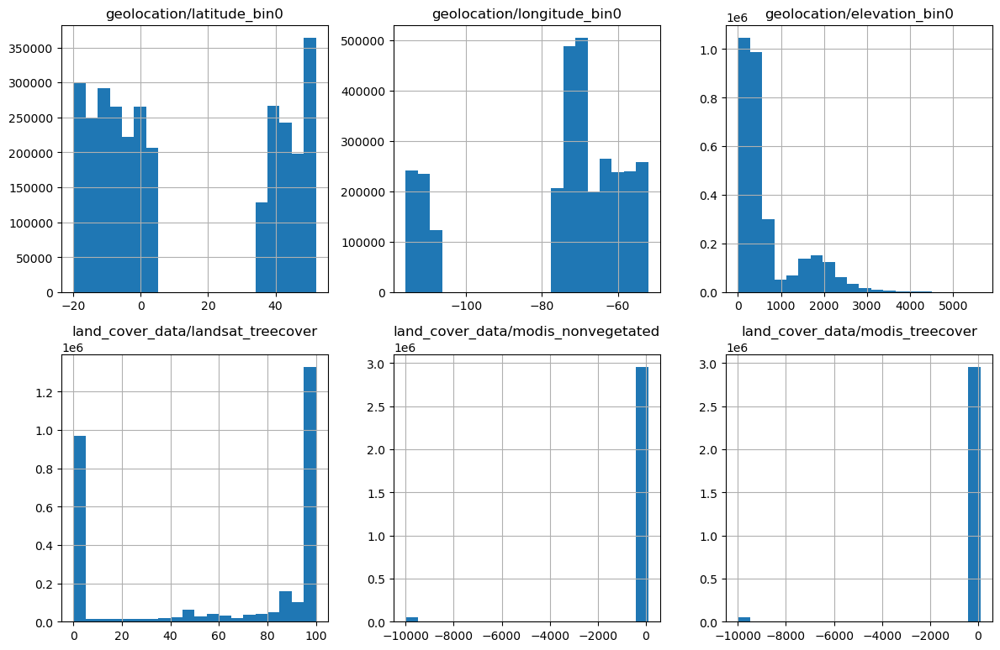

In [6]:
df[condition_columns].hist(bins=20, figsize=(12, 8), layout=(2, 3))
plt.tight_layout()
plt.show()

- Latitude (bin0) Range: (-20, 5), (35, 52)
- Longitude (bin0) Range: (-116, -106), (-77, -52)
- Elevation (bin0) Range: (0, 1000) [dense], (1000, 4500)

In [7]:
# Select rows where "land_cover_data/modis_nonvegetated" < 0 OR "land_cover_data/modis_treecover" < 0
cond_or = (df['land_cover_data/modis_nonvegetated'] < 0) | (df['land_cover_data/modis_treecover'] < 0)
num_rows_or = df[cond_or].shape[0]
print("Number of rows (OR condition):", num_rows_or)

# Select rows where "land_cover_data/modis_nonvegetated" < 0 AND "land_cover_data/modis_treecover" < 0
cond_and = (df['land_cover_data/modis_nonvegetated'] < 0) & (df['land_cover_data/modis_treecover'] < 0)
num_rows_and = df[cond_and].shape[0]
print("Number of rows (AND condition):", num_rows_and)

Number of rows (OR condition): 48062
Number of rows (AND condition): 48062


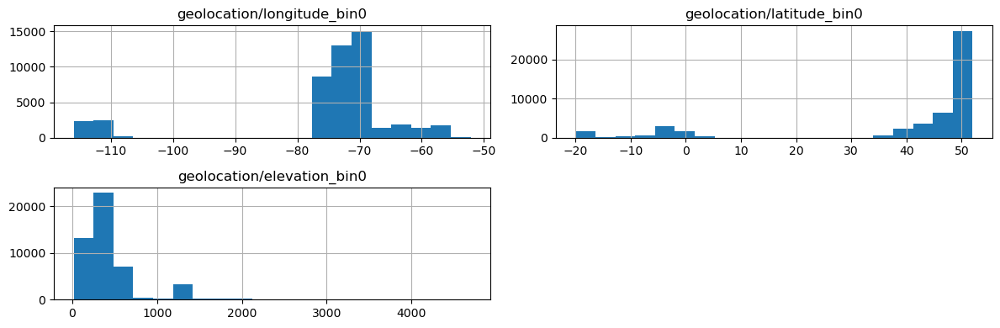

In [8]:
# Filter rows where "land_cover_data/modis_nonvegetated" < 0
subset = df[df['land_cover_data/modis_nonvegetated'] < 0]

# Define the columns for longitude, latitude, and elevation bin0
cols_to_plot = ['geolocation/longitude_bin0', 'geolocation/latitude_bin0', 'geolocation/elevation_bin0']

# Plot histograms for the selected columns
subset[cols_to_plot].hist(bins=20, figsize=(12, 4))
plt.tight_layout()
plt.show()

In [9]:
df2 = df[(df['land_cover_data/modis_nonvegetated'] >= 0) &
         (df['land_cover_data/modis_treecover'] >= 0)]
print(df2.shape)


(2951938, 27)


In [10]:
df2.to_pickle("data/gedi/combined_df_preprocessed_2.pkl")


In [4]:
df2 = pandas.read_pickle("data/gedi/combined_df_preprocessed_2.pkl")

In [5]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2951938 entries, 0 to 2999999
Data columns (total 27 columns):
 #   Column                              Dtype  
---  ------                              -----  
 0   rh                                  object 
 1   dataset                             object 
 2   y_normalized                        object 
 3   rx_sample_start_index               float64
 4   rx_sample_count                     float64
 5   geolocation/latitude_bin0           float64
 6   geolocation/longitude_bin0          float64
 7   geolocation/elevation_bin0          float64
 8   geolocation/elevation_lastbin       float64
 9   geolocation/delta_time              float64
 10  shot_number                         float64
 11  quality_flag                        float64
 12  sensitivity                         float64
 13  solar_elevation                     float64
 14  degrade_flag                        float64
 15  elev_lowestmode                     float64
 16  elev_

Mean: 0.001953125, Std Dev: 0.003209996037185192
Mean: 0.001953125, Std Dev: 0.0031252214685082436
Mean: 0.001953125, Std Dev: 0.0016556719783693552
Mean: 0.0019531248835846782, Std Dev: 0.001908470643684268
Mean: 0.0019531248835846782, Std Dev: 0.0026082843542099
Mean: 0.0019531248835846782, Std Dev: 0.003954893443733454
Mean: 0.0019531247671693563, Std Dev: 0.00303209968842566
Mean: 0.0019531247671693563, Std Dev: 0.005668229889124632
Mean: 0.001953125, Std Dev: 0.003177011152729392
Mean: 0.001953125, Std Dev: 0.0018802653066813946
Mean: 0.001953125, Std Dev: 0.004602773115038872
Mean: 0.001953125, Std Dev: 0.004159138537943363
Mean: 0.0019531248835846782, Std Dev: 0.002597570652142167
Mean: 0.001953125, Std Dev: 0.0025811067316681147
Mean: 0.001953125, Std Dev: 0.005700994748622179
Mean: 0.0019531248835846782, Std Dev: 0.002816705731675029
Mean: 0.001953125, Std Dev: 0.005566295702010393
Mean: 0.0019531248835846782, Std Dev: 0.0014104102738201618
Mean: 0.0019531248835846782, Std Dev

ValueError: Too many bins for data range. Cannot create 10 finite-sized bins.

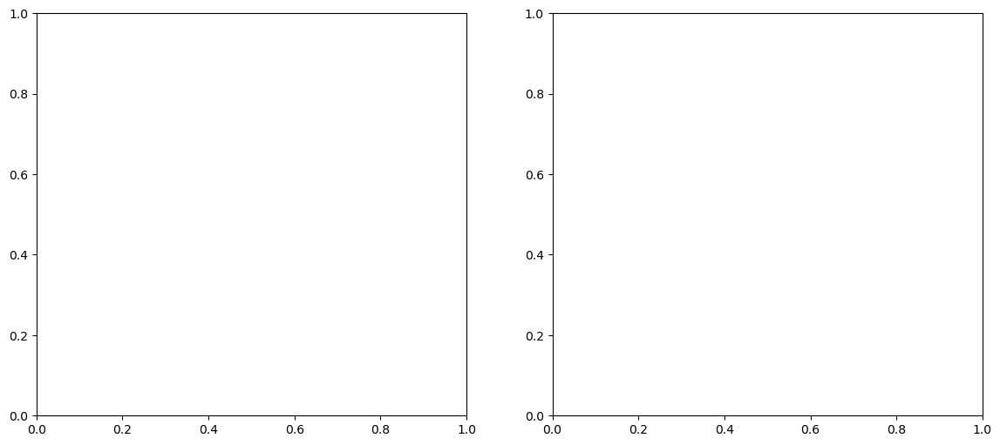

In [ ]:
# Sample 10% of the rows for analysis
sample_df = df2.sample(frac=0.2, random_state=42)

mean_list = []
sd_list = []

# Calculate mean and standard deviation for each row's y_normalized list
for _, row in sample_df.iterrows():
    y_vals = row['y_normalized']
    # Convert to numpy array for computation (assuming it's already a list)
    y_arr = np.array(y_vals)
    mean_list.append(np.mean(y_arr))
    sd_list.append(np.std(y_arr))
    print(f"Mean: {mean_list[-1]}, Std Dev: {sd_list[-1]}")


In [ ]:

# Plot histograms of the means and standard deviations
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

axs[0].hist(mean_list)
axs[0].set_title('Histogram of y_normalized Means')
axs[0].set_xlabel('Mean')
axs[0].set_ylabel('Frequency')

axs[1].hist(sd_list)
axs[1].set_title('Histogram of y_normalized Standard Deviations')
axs[1].set_xlabel('Standard Deviation')
axs[1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

In [11]:
print(f"Mean of means: {np.mean(mean_list)}, Std Dev of means: {np.std(mean_list)}")

Mean of means: 0.001953125, Std Dev of means: 1.2659123749259038e-10


In [12]:
print(f"Mean of std devs: {np.mean(sd_list)}, Std Dev of std devs: {np.std(sd_list)}")

Mean of std devs: 0.004129360895603895, Std Dev of std devs: 0.001818662858568132


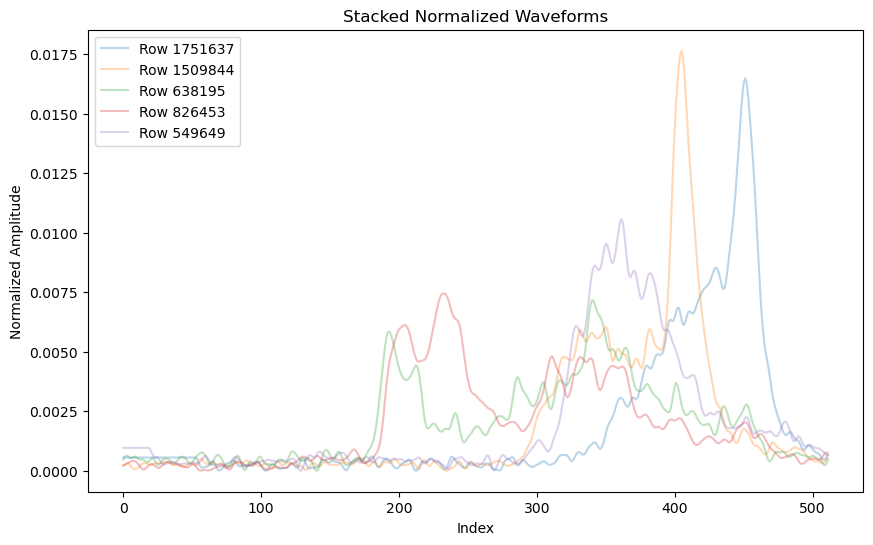

In [13]:
# Plot a few normalized waveforms from sample_df, stacking them with low alpha

plt.figure(figsize=(10, 6))
# Take the first 5 rows for demonstration
for idx, row in sample_df.head(5).iterrows():
    # Get the normalized waveform and ensure it's a numpy array
    y_norm = np.array(row['y_normalized'])
    plt.plot(y_norm, alpha=0.3, label=f'Row {row.name}')

plt.title("Stacked Normalized Waveforms")
plt.xlabel("Index")
plt.ylabel("Normalized Amplitude")
plt.legend()
plt.show()

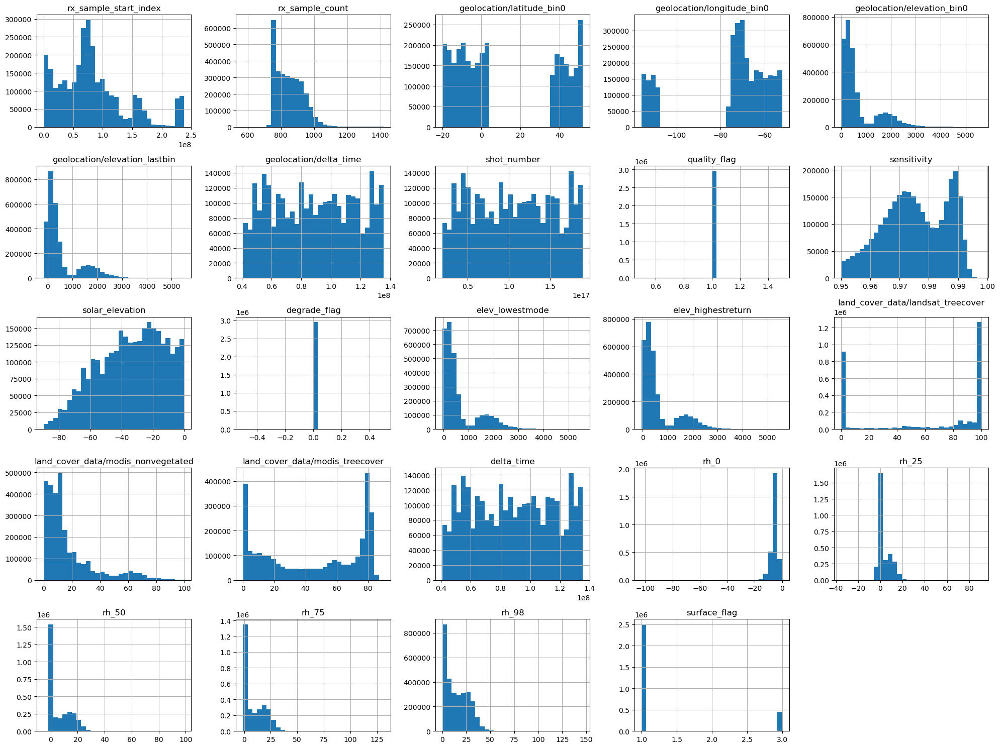

In [13]:
# Plot histograms for numeric columns
numeric_columns = df2.select_dtypes(include=[np.number]).columns.tolist()

df2[numeric_columns].hist(bins=30, figsize=(20, 15))
plt.tight_layout()
plt.show()


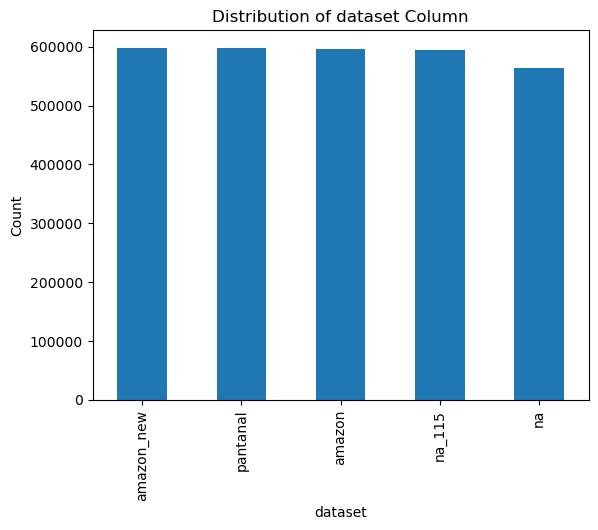

In [14]:
df2['dataset'].value_counts().plot(kind='bar', title='Distribution of dataset Column')
plt.xlabel('dataset')
plt.ylabel('Count')
plt.show()

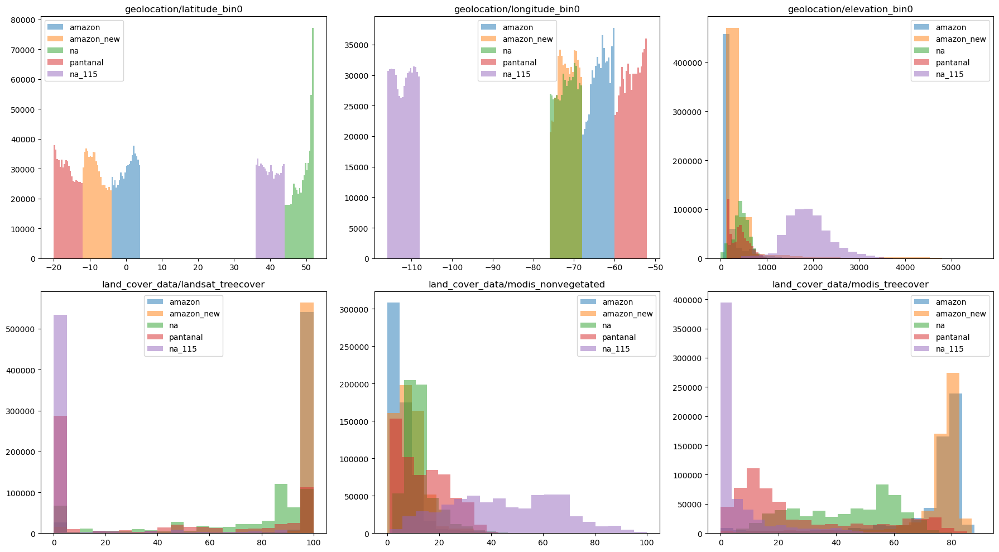

In [15]:
columns = ['geolocation/latitude_bin0', 'geolocation/longitude_bin0', 'geolocation/elevation_bin0',
           'land_cover_data/landsat_treecover', 'land_cover_data/modis_nonvegetated', 'land_cover_data/modis_treecover']
datasets = df2['dataset'].unique()

# Create subplots with 2 rows and 3 columns
fig, axs = plt.subplots(2, 3, figsize=(18, 10))
axs = axs.flatten()  # flatten to a 1D array for easy iteration

for ds in datasets:
    subset = df2[df2['dataset'] == ds]
    for ax, col in zip(axs, columns):
        ax.hist(subset[col], bins=20, alpha=0.5, label=ds)
        ax.set_title(col)
        ax.legend()
        
plt.tight_layout()
plt.show()

- Latitude (bin0) Range: (-20, 5), (35, 52)
- Longitude (bin0) Range: (-116, -108), (-77, -52)
- Elevation (bin0) Range: (0, 1000) [dense], (1000, 4500) [mainly na_115]
- Landsat treecover: too bimodal, not quite useful 
- Modis nonvegetated: (0, 40) [dense], (0, 100) [mainly na_115, sparse]
- Modis treecover: (0, 85), 2 modes at 0 [na_115] and 80 [amazon & amazon_new]



- what is modis: 
    - MODIS (Moderate Resolution Imaging Spectroradiometer) is a key instrument aboard NASA's Terra and Aqua satellites. It captures data in 36 spectral bands, providing information on land surface temperature, vegetation cover, and other environmental parameters.
    - MODIS data is used for various applications, including monitoring land cover changes, assessing vegetation health, and studying climate patterns.
- what is landsat:
    - Landsat is a series of Earth-observing satellites that have been capturing images of the Earth's surface since 1972. The Landsat program provides high-resolution imagery, which is used for land cover mapping, agricultural monitoring, and environmental studies.
    - Landsat data is valuable for long-term land use change analysis and provides a historical perspective on Earth's surface changes.


Original distribution across bins:
modis_treecover_bin
[0-10)      650035
[70-80)     575027
[80-90)     464747
[10-20)     325981
[60-70)     220701
[50-60)     217187
[20-30)     192530
[40-50)     153523
[30-40)     152205
[90-100)         2
Name: count, dtype: int64


/tmp/ipykernel_923945/22941864.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_balanced = df2.groupby('modis_treecover_bin', group_keys=False).apply(



Shape of original dataframe: (2951938, 28)
Shape of balanced dataframe: (1698260, 27)


/tmp/ipykernel_923945/22941864.py:27: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_balanced = df2.groupby('modis_treecover_bin', group_keys=False).apply(


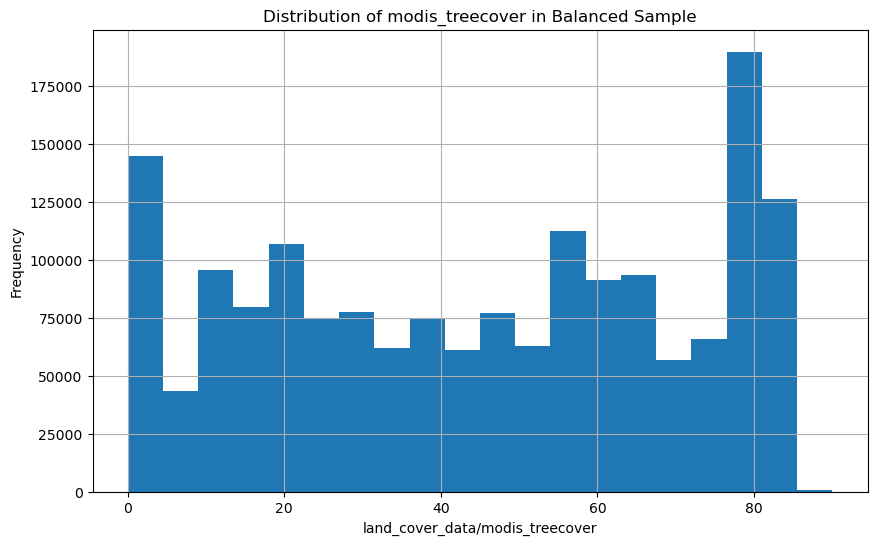


Balanced distribution across bins:
modis_treecover_bin
[0-10)      200000
[10-20)     200000
[50-60)     200000
[80-90)     200000
[70-80)     200000
[60-70)     200000
[20-30)     192530
[40-50)     153523
[30-40)     152205
[90-100)         2
Name: count, dtype: int64


In [18]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

# Define bins for the 'land_cover_data/modis_treecover' column
bin_edges = np.arange(0, 101, 10) # Bins of size 10 from 0 to 100
bin_labels = [f'[{i}-{i+10})' for i in bin_edges[:-1]]

# Create a new column with bin labels
df2['modis_treecover_bin'] = pd.cut(df2['land_cover_data/modis_treecover'], bins=bin_edges, labels=bin_labels, right=False, include_lowest=True)

# Calculate value counts for each bin
bin_counts = df2['modis_treecover_bin'].value_counts()
print("Original distribution across bins:")
print(bin_counts)

# Determine the number of samples per bin (e.g., cap at a certain number or use the minimum)
# Let's cap the number of samples per bin to make it more balanced, e.g., 50000
# Or find a bin with a reasonable number of samples and use that as the cap
# Let's look at the counts and decide. The counts vary significantly.
# Let's try capping at the count of a less populated bin, or a fixed number like 50k or 100k.
# Choosing 50,000 as a target sample size per bin.
n_samples_per_bin = 200000

# Sample from each bin
df_balanced = df2.groupby('modis_treecover_bin', group_keys=False).apply(
    lambda x: x.sample(min(len(x), n_samples_per_bin), random_state=42)
)

# Drop the temporary bin column
df_balanced = df_balanced.drop(columns=['modis_treecover_bin'])

print(f"\nShape of original dataframe: {df2.shape}")
print(f"Shape of balanced dataframe: {df_balanced.shape}")

# Plot the distribution of the balanced dataframe
plt.figure(figsize=(10, 6))
df_balanced['land_cover_data/modis_treecover'].hist(bins=20)
plt.title('Distribution of modis_treecover in Balanced Sample')
plt.xlabel('land_cover_data/modis_treecover')
plt.ylabel('Frequency')
plt.show()

# Display value counts for the balanced data bins (optional check)
df_balanced['modis_treecover_bin'] = pd.cut(df_balanced['land_cover_data/modis_treecover'], bins=bin_edges, labels=bin_labels, right=False, include_lowest=True)
print("\nBalanced distribution across bins:")
print(df_balanced['modis_treecover_bin'].value_counts())
df_balanced = df_balanced.drop(columns=['modis_treecover_bin']) # Clean up again

In [19]:
# the balanced dataframe Export to a pickle file
df_balanced.to_pickle("data/gedi/combined_df_balanced.pkl")

print("Balanced dataframe exported to data/gedi/combined_df_balanced.pkl") 

Balanced dataframe exported to data/gedi/combined_df_balanced.pkl


In [20]:
print("Original dataframe shape:", df2.shape)
print("Balanced dataframe shape:", df_balanced.shape)

Original dataframe shape: (2951938, 28)
Balanced dataframe shape: (1698260, 27)


In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas
import pandas as pd

In [2]:
df_balanced = pd.read_pickle("data/gedi/combined_df_balanced.pkl")
print(df_balanced.info())

<class 'pandas.core.frame.DataFrame'>
Index: 1698260 entries, 2407147 to 2003095
Data columns (total 27 columns):
 #   Column                              Dtype  
---  ------                              -----  
 0   rh                                  object 
 1   dataset                             object 
 2   y_normalized                        object 
 3   rx_sample_start_index               float64
 4   rx_sample_count                     float64
 5   geolocation/latitude_bin0           float64
 6   geolocation/longitude_bin0          float64
 7   geolocation/elevation_bin0          float64
 8   geolocation/elevation_lastbin       float64
 9   geolocation/delta_time              float64
 10  shot_number                         float64
 11  quality_flag                        float64
 12  sensitivity                         float64
 13  solar_elevation                     float64
 14  degrade_flag                        float64
 15  elev_lowestmode                     float64
 16 

In [ ]:
TrainDatasety())
print("Stacked array shape:", y_array.shape)

# Calculate the mean and standard deviation for each index position in the lists.
mean_y = np.mean(y_array)
std_y = np.std(y_array)

print("Mean per index:", mean_y)
print("Std per index:", std_y)

Stacked array shape: (1698260, 512)
Mean per index: 0.001953125
Std per index: 0.004507618


In [4]:
# Renormalize the 'y_normalized' column: 
# for each row convert the list to a numpy array, subtract mean_y, and divide by std_y.

df_balanced['y_normalized'] = df_balanced['y_normalized'].apply(lambda y: (np.array(y) - mean_y) / std_y)

In [7]:
# Compute and print the new overall mean and standard deviation of the renormalized 'y_normalized' column.
y_array_new = np.vstack(df_balanced['y_normalized'].to_numpy())
new_mean = np.mean(y_array_new)
new_std = np.std(y_array_new)
print(f"New mean: {new_mean}, New std: {new_std}")

New mean: -7.330456380794104e-11, New std: 1.0000015497207642


In [5]:
from sklearn.model_selection import train_test_split
# Define bins for the 'land_cover_data/modis_treecover' column
bin_edges = np.arange(0, 101, 10) # Bins of size 10 from 0 to 100
bin_labels = [f'[{i}-{i+10})' for i in bin_edges[:-1]]

In [6]:
# Create a categorical column for stratification based on the modis_treecover column.
# We use the bin_edges and bin_labels defined earlier in cell 27.
df_balanced['modis_treecover_cat'] = pd.cut(
    df_balanced['land_cover_data/modis_treecover'],
    bins=bin_edges,
    labels=bin_labels,
    right=False,
    include_lowest=True
)

# Perform stratified splitting using the new categorical column.
train, temp = train_test_split(
    df_balanced,
    test_size=0.2,
    random_state=42,
    stratify=df_balanced['modis_treecover_cat']
)
val, test = train_test_split(
    temp,
    test_size=0.5,
    random_state=42,
    stratify=temp['modis_treecover_cat']
)

# Drop the temporary stratification column from the splits.
train = train.drop(columns=['modis_treecover_cat'])
val = val.drop(columns=['modis_treecover_cat'])
test = test.drop(columns=['modis_treecover_cat'])

# Save the splits to pickle files.
train.to_pickle("data/gedi/combined_df_train.pkl")
val.to_pickle("data/gedi/combined_df_val.pkl")
test.to_pickle("data/gedi/combined_df_test.pkl")

print("Train shape:", train.shape)
print("Validation shape:", val.shape)
print("Test shape:", test.shape)
print("Pickle files saved to disk.")


Train shape: (1358608, 27)
Validation shape: (169826, 27)
Test shape: (169826, 27)
Pickle files saved to disk.
